In [5]:
import numpy as np
import pandas as pd

import urllib.request
from PIL import Image

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import SelectKBest
from sklearn import svm, datasets
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt


In [6]:
df = pd.read_csv("diamonds_train.csv", index_col=0)
df

,carat,cut,color,clarity,depth,table,x,y,z,price
0,1.21,Ideal,H,VS2,63.0,57.0,6.73,6.70,4.23,6134
1,0.28,Very Good,D,VVS2,64.0,56.0,4.14,4.17,2.66,532
2,0.42,Premium,F,VS1,61.2,58.0,4.86,4.82,2.96,1103
3,0.26,Ideal,H,IF,61.1,57.0,4.16,4.12,2.53,600
4,1.10,Good,G,SI1,63.4,57.0,6.52,6.55,4.14,4997
...,...,...,...,...,...,...,...,...,...,...
40340,1.55,Premium,H,VS2,61.3,61.0,7.46,7.39,4.55,11708
40341,0.36,Ideal,D,SI1,60.6,56.0,4.58,4.63,2.79,619
40342,0.57,Very Good,I,VS2,62.2,55.0,5.33,5.34,3.32,1267
40343,1.01,Very Good,F,IF,59.6,62.0,6.47,6.56,3.88,9965


In [10]:
df.corr()

,carat,depth,table,x,y,z,price
carat,1.000000,0.029414,0.181273,0.975077,0.944445,0.967289,0.921887
depth,0.029414,1.000000,-0.288987,-0.023389,-0.027880,0.097399,-0.009228
table,0.181273,-0.288987,1.000000,0.193986,0.180449,0.153175,0.127338
x,0.975077,-0.023389,0.193986,1.000000,0.966827,0.985080,0.883163
y,0.944445,-0.027880,0.180449,0.966827,1.000000,0.959957,0.857564
z,0.967289,0.097399,0.153175,0.985080,0.959957,1.000000,0.872855
price,0.921887,-0.009228,0.127338,0.883163,0.857564,0.872855,1.000000


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40345 entries, 0 to 40344
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    40345 non-null  float64
 1   cut      40345 non-null  object 
 2   color    40345 non-null  object 
 3   clarity  40345 non-null  object 
 4   depth    40345 non-null  float64
 5   table    40345 non-null  float64
 6   x        40345 non-null  float64
 7   y        40345 non-null  float64
 8   z        40345 non-null  float64
 9   price    40345 non-null  int64  
dtypes: float64(6), int64(1), object(3)
memory usage: 3.4+ MB


array([[<AxesSubplot:title={'center':'carat'}>,
        <AxesSubplot:title={'center':'depth'}>,
        <AxesSubplot:title={'center':'table'}>],
       [<AxesSubplot:title={'center':'x'}>,
        <AxesSubplot:title={'center':'y'}>,
        <AxesSubplot:title={'center':'z'}>],
       [<AxesSubplot:title={'center':'price'}>, <AxesSubplot:>,
        <AxesSubplot:>]], dtype=object)

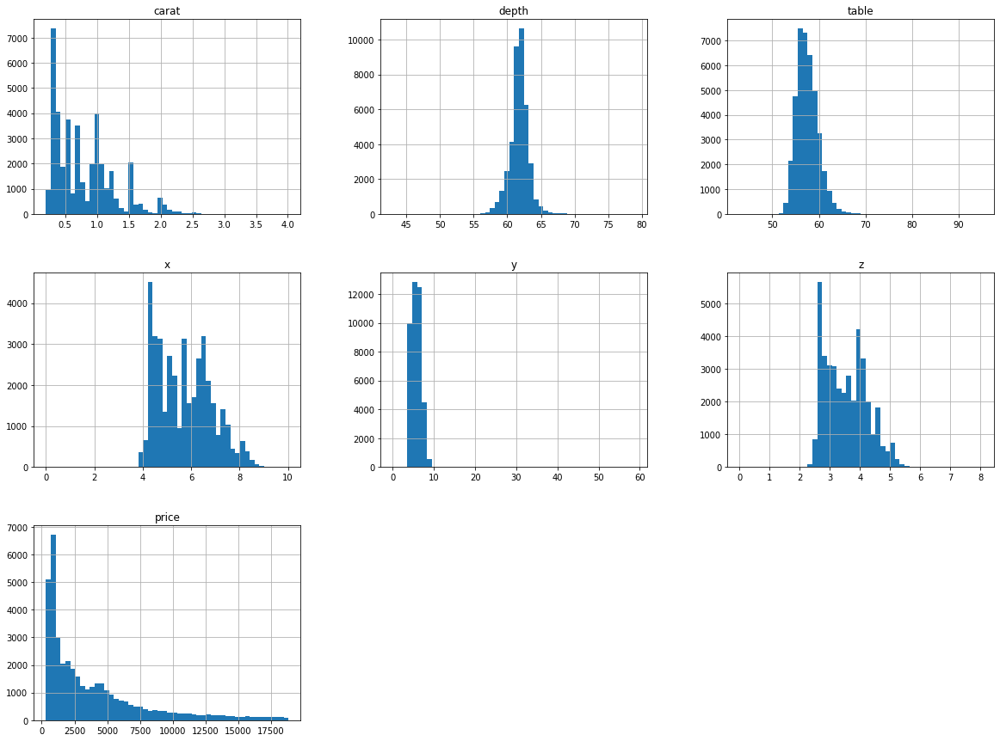

In [12]:
df.hist(bins=50, figsize=(20,15))

In [7]:
x = df.iloc[:,:-1]
x

,carat,cut,color,clarity,depth,table,x,y,z
0,1.21,Ideal,H,VS2,63.0,57.0,6.73,6.70,4.23
1,0.28,Very Good,D,VVS2,64.0,56.0,4.14,4.17,2.66
2,0.42,Premium,F,VS1,61.2,58.0,4.86,4.82,2.96
3,0.26,Ideal,H,IF,61.1,57.0,4.16,4.12,2.53
4,1.10,Good,G,SI1,63.4,57.0,6.52,6.55,4.14
...,...,...,...,...,...,...,...,...,...
40340,1.55,Premium,H,VS2,61.3,61.0,7.46,7.39,4.55
40341,0.36,Ideal,D,SI1,60.6,56.0,4.58,4.63,2.79
40342,0.57,Very Good,I,VS2,62.2,55.0,5.33,5.34,3.32
40343,1.01,Very Good,F,IF,59.6,62.0,6.47,6.56,3.88


In [8]:
y = df['price']
y

0         6134
1          532
2         1103
3          600
4         4997
         ...  
40340    11708
40341      619
40342     1267
40343     9965
40344     1340
Name: price, Length: 40345, dtype: int64

In [15]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state= 42)

<AxesSubplot:xlabel='carat', ylabel='price'>

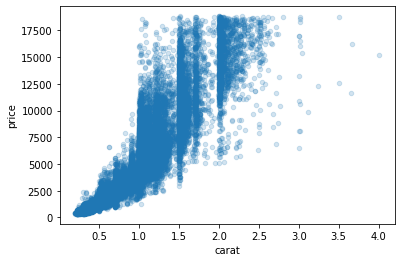

In [9]:
df.plot(kind= 'scatter', x= 'carat', y= 'price', alpha= 0.2)

<AxesSubplot:xlabel='carat', ylabel='cut'>

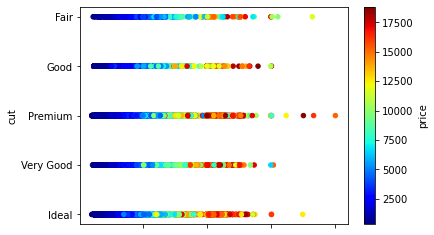

In [10]:
df.plot(kind= 'scatter', x= 'carat', y= 'cut', c= 'price', cmap= plt.get_cmap('jet'))

In [15]:
for i,val in enumerate(x['cut']):
    if val == 'Fair':
        x['cut'][i] = 1
    elif val == 'Good':
        x['cut'][i] = 5
    elif val == 'Very Good':
       x['cut'][i] = 10
    elif val == 'Ideal':
       x['cut'][i] = 20
    elif val == 'Premium':
      x['cut'][i] = 40

ipykernel_launcher:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
ipykernel_launcher:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
ipykernel_launcher:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
ipykernel_launcher:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-v

In [16]:
x

,carat,cut,color,clarity,depth,table,x,y,z
0,1.21,20,H,VS2,63.0,57.0,6.73,6.70,4.23
1,0.28,10,D,VVS2,64.0,56.0,4.14,4.17,2.66
2,0.42,40,F,VS1,61.2,58.0,4.86,4.82,2.96
3,0.26,20,H,IF,61.1,57.0,4.16,4.12,2.53
4,1.10,5,G,SI1,63.4,57.0,6.52,6.55,4.14
...,...,...,...,...,...,...,...,...,...
40340,1.55,40,H,VS2,61.3,61.0,7.46,7.39,4.55
40341,0.36,20,D,SI1,60.6,56.0,4.58,4.63,2.79
40342,0.57,10,I,VS2,62.2,55.0,5.33,5.34,3.32
40343,1.01,10,F,IF,59.6,62.0,6.47,6.56,3.88


<AxesSubplot:xlabel='carat', ylabel='clarity'>

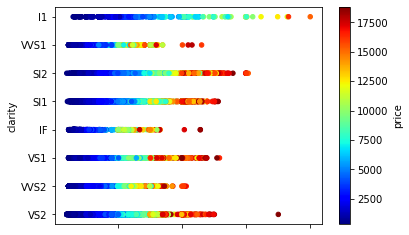

In [18]:
df.plot(kind= 'scatter', x= 'carat', y= 'clarity', c= 'price', cmap= plt.get_cmap('jet'))

<AxesSubplot:xlabel='carat', ylabel='color'>

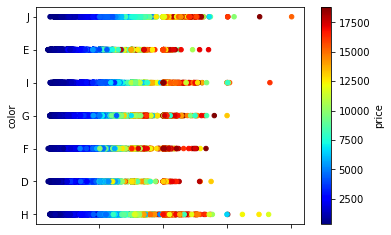

In [19]:
df.plot(kind= 'scatter', x= 'carat', y= 'color', c= 'price', cmap= plt.get_cmap('jet'))

In [20]:
x =  x.drop(['depth', 'table'], axis=1)
x

,carat,cut,color,clarity,x,y,z
0,1.21,Ideal,H,VS2,6.73,6.70,4.23
1,0.28,Very Good,D,VVS2,4.14,4.17,2.66
2,0.42,Premium,F,VS1,4.86,4.82,2.96
3,0.26,Ideal,H,IF,4.16,4.12,2.53
4,1.10,Good,G,SI1,6.52,6.55,4.14
...,...,...,...,...,...,...,...
40340,1.55,Premium,H,VS2,7.46,7.39,4.55
40341,0.36,Ideal,D,SI1,4.58,4.63,2.79
40342,0.57,Very Good,I,VS2,5.33,5.34,3.32
40343,1.01,Very Good,F,IF,6.47,6.56,3.88


In [21]:
x.cut.value_counts()

Ideal        16090
Premium      10339
Very Good     9036
Good          3694
Fair          1186
Name: cut, dtype: int64

In [22]:
x.clarity.value_counts()

SI1     9751
VS2     9178
SI2     6828
VS1     6101
VVS2    3858
VVS1    2714
IF      1362
I1       553
Name: clarity, dtype: int64

In [23]:
x.color.value_counts()

G    8499
E    7351
F    7130
H    6234
D    5074
I    4023
J    2034
Name: color, dtype: int64

In [24]:
le = LabelEncoder()
le.fit(df.cut)

LabelEncoder()

In [25]:
data = le.fit_transform(df.cut)
data

array([2, 4, 3, ..., 4, 4, 2])

In [26]:
le.transform(['Ideal'])

array([2])

In [27]:
le.fit(['Fair', 'Good', 'Very Good', 'Ideal', 'Premium'])

LabelEncoder()

In [28]:
data = le.fit_transform(x.cut)
data

array([2, 4, 3, ..., 4, 4, 2])

In [29]:
le.transform(['Premium'])

array([3])

In [30]:
x.cut = le.fit_transform(x.cut)
df

,carat,cut,color,clarity,depth,table,x,y,z,price
0,1.21,Ideal,H,VS2,63.0,57.0,6.73,6.70,4.23,6134
1,0.28,Very Good,D,VVS2,64.0,56.0,4.14,4.17,2.66,532
2,0.42,Premium,F,VS1,61.2,58.0,4.86,4.82,2.96,1103
3,0.26,Ideal,H,IF,61.1,57.0,4.16,4.12,2.53,600
4,1.10,Good,G,SI1,63.4,57.0,6.52,6.55,4.14,4997
...,...,...,...,...,...,...,...,...,...,...
40340,1.55,Premium,H,VS2,61.3,61.0,7.46,7.39,4.55,11708
40341,0.36,Ideal,D,SI1,60.6,56.0,4.58,4.63,2.79,619
40342,0.57,Very Good,I,VS2,62.2,55.0,5.33,5.34,3.32,1267
40343,1.01,Very Good,F,IF,59.6,62.0,6.47,6.56,3.88,9965


In [31]:
ce = LabelEncoder()
ce.fit(x.color)

LabelEncoder()

In [32]:
x.color = ce.fit_transform(x.color)

In [33]:
clar_enc = LabelEncoder()
clar_enc.fit(x.clarity)
x.clarity = clar_enc.fit_transform(x.clarity)

In [34]:
x

,carat,cut,color,clarity,x,y,z
0,1.21,2,4,5,6.73,6.70,4.23
1,0.28,4,0,7,4.14,4.17,2.66
2,0.42,3,2,4,4.86,4.82,2.96
3,0.26,2,4,1,4.16,4.12,2.53
4,1.10,1,3,2,6.52,6.55,4.14
...,...,...,...,...,...,...,...
40340,1.55,3,4,5,7.46,7.39,4.55
40341,0.36,2,0,2,4.58,4.63,2.79
40342,0.57,4,5,5,5.33,5.34,3.32
40343,1.01,4,2,1,6.47,6.56,3.88


In [35]:
scaler = StandardScaler()
standard_x = scaler.fit_transform(x)
standard_x

array([[ 0.88009271, -0.53933659,  0.83365837, ...,  0.89739454,
         0.84433944,  1.00174548],
       [-1.09526671,  1.40826105, -1.52591487, ..., -1.41784198,
        -1.3583998 , -1.26163392],
       [-0.79790077,  0.43446223, -0.34612825, ..., -0.77422411,
        -0.79247865, -0.82914104],
       ...,
       [-0.47929442,  1.40826105,  1.42355167, ..., -0.35408466,
        -0.33974173, -0.31014958],
       [ 0.45528423,  1.40826105, -0.34612825, ...,  0.66497697,
         0.72244873,  0.49717046],
       [-0.54301569, -0.53933659, -0.93602156, ..., -0.35408466,
        -0.40068709, -0.48314673]])

In [36]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state= 42)

In [37]:
pipe = Pipeline(steps=[
    ('regressor', RandomForestRegressor())
])

linear_reyg_params = {
    'regressor': [LinearRegression()],
    'regressor__n_jobs': [1, 2, 3]
}

random_forest_params = {
    'regressor': [RandomForestRegressor()],
    'regressor__n_estimators': [10, 100, 1000],
    'regressor__max_features': [1,2,3]
}

svm_params = {
    'regressor': [svm.SVR()],
    'regressor__kernel': ('linear', 'rbf', 'sigmoid'),
    'regressor__C': [0.001, 0.1, 0.5, 1, 5, 10],
    'regressor__gamma': ('scale', 'auto')
    
}

search_space = [
    linear_reg_params,
    random_forest_params,
    svm_params
]

clf = GridSearchCV(estimator = pipe,
                  param_grid = search_space,
                  cv = 10,
                  verbose=50,
                  n_jobs=-1)

clf.fit(x_train, y_train)

Fitting 10 folds for each of 48 candidates, totalling 480 fits
C:\Users\jarai\AppData\Local\Programs\Python\Python37\lib\site-packages\sklearn\model_selection\_search.py:925: UserWarning: One or more of the test scores are non-finite: [ 0.88190865  0.88190865  0.88190865  0.96033223  0.96681527         nan
  0.97121436  0.9749563   0.97538506  0.97553055  0.97844016  0.9785967
 -0.11372114 -0.14856965 -0.14969082 -0.11372114 -0.14885604 -0.14967492
  0.65359314 -0.04567101 -0.15126663  0.65359314 -0.07215586 -0.14967452
  0.74341664  0.28715908 -0.15749299  0.74341664  0.18328927 -0.1496729
  0.76587761  0.4775699  -0.16483733  0.76587761  0.34818493 -0.14967087
  0.83078973  0.77750708 -0.22894515  0.83078973  0.70858559 -0.14965228
  0.85169605  0.84993707 -0.32355457  0.85169605  0.81673853 -0.14963085]
  category=UserWarning


GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('regressor', RandomForestRegressor())]),
             n_jobs=-1,
             param_grid=[{'regressor': [LinearRegression()],
                          'regressor__n_jobs': [1, 2, 3]},
                         {'regressor': [RandomForestRegressor(max_features=3,
                                                              n_estimators=1000)],
                          'regressor__max_features': [1, 2, 3],
                          'regressor__n_estimators': [10, 100, 1000]},
                         {'regressor': [SVR()],
                          'regressor__C': [0.001, 0.1, 0.5, 1, 5, 10],
                          'regressor__gamma': ('scale', 'auto'),
                          'regressor__kernel': ('linear', 'rbf', 'sigmoid')}],
             verbose=50)

In [38]:
clf.best_estimator_

Pipeline(steps=[('regressor',
                 RandomForestRegressor(max_features=3, n_estimators=1000))])

In [39]:
clf.score(x_test, y_test)

0.9788248682234908

In [40]:
clf.score(x_train, y_train)

0.9971130717568119

In [2]:
rand_forest = RandomForestRegressor(max_features= 3, n_estimators= 1000)

NameError: name 'RandomForestRegressor' is not defined